In [66]:
import json
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os
import numpy as np
import glob
import cv2
import torchstain
import torch
from torchvision import transforms
import torchstain
import cv2

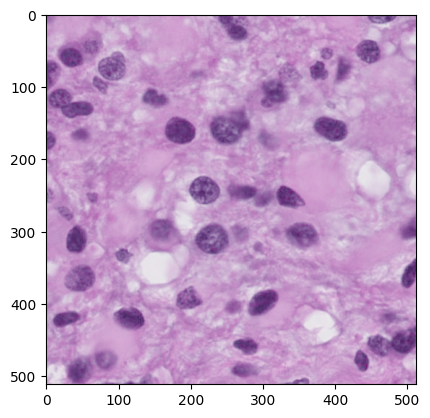

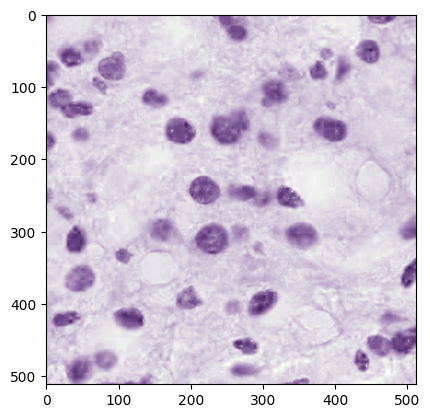

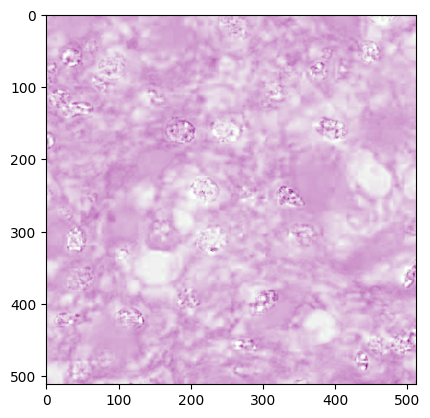

In [67]:
# Reinhard normalization using OpenCV
def reinhard_normalization(image, target_image):
    target = cv2.cvtColor(cv2.imread(target_image), cv2.COLOR_BGR2RGB)
    to_transform = cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2RGB)
    # plt.imshow(target)
    # plt.show()
    # plt.imshow(to_transform)
    # plt.show()
    T = transforms.Compose([
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x*255)
    ])

    normalizer = torchstain.normalizers.MacenkoNormalizer(backend='torch')
    normalizer.fit(T(target))

    t_to_transform = T(to_transform)
    norm, H, E = normalizer.normalize(I=t_to_transform, stains=True)
    return norm, H, E
norm, H, E = reinhard_normalization('Data_122824/Glioma_MDC_2025_test/testing0193.jpg','Data_122824/Glioma_MDC_2025_training/training0004.jpg')

plt.imshow(norm)
plt.show()
plt.imshow(H)
plt.show()
plt.imshow(E)
plt.show()

In [47]:
Image.open('Data_122824/Glioma_MDC_2025_test/testing0193.jpg').size

(512, 512)

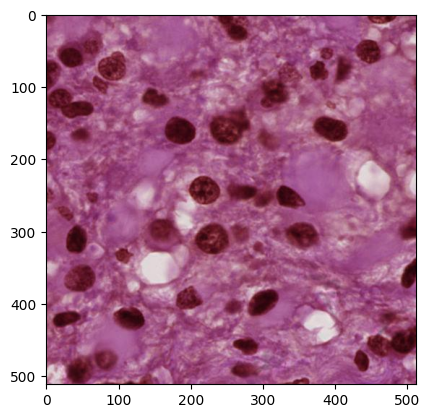

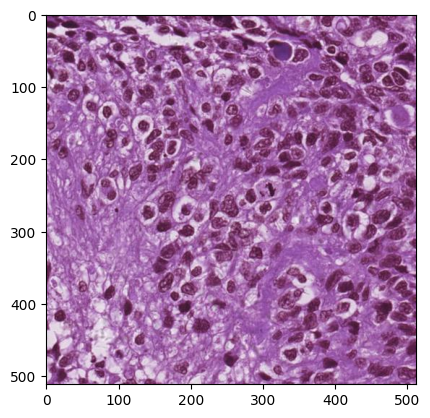

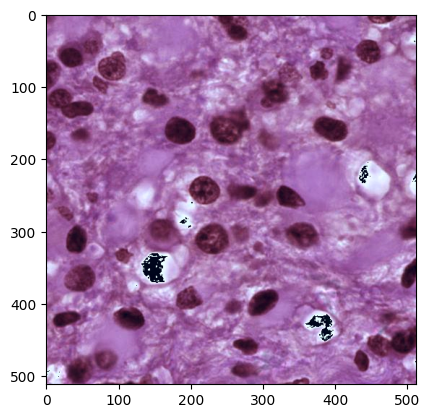

In [25]:
image = cv2.imread('Data_122824/Glioma_MDC_2025_test/testing0193.jpg')
target_image = cv2.imread('Data_122824/Glioma_MDC_2025_test/testing0001.jpg')
normalized_image = reinhard_normalization(image, target_image)
plt.imshow(image)
plt.show()
plt.imshow(target_image)
plt.show()
plt.imshow(normalized_image)
plt.show()

Data_122824/Glioma_MDC_2025_test/testing0013.jpg Data_122824/Glioma_MDC_2025_test/testing0013.json


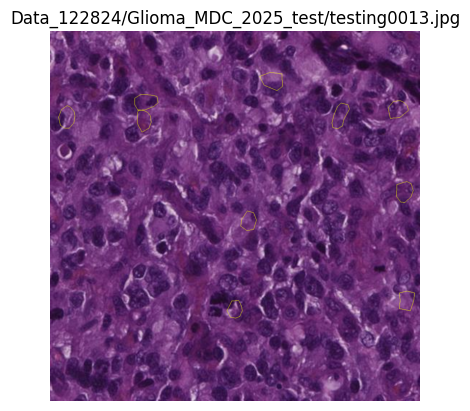

Data_122824/Glioma_MDC_2025_test/testing0015.jpg Data_122824/Glioma_MDC_2025_test/testing0015.json


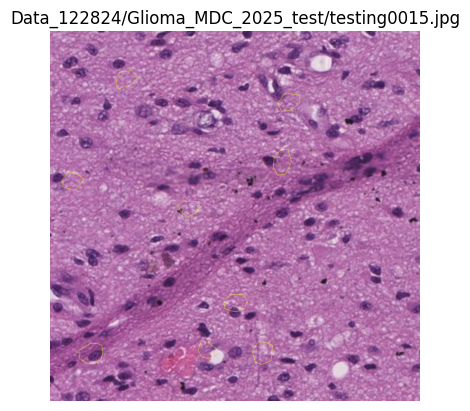

In [68]:
# show the patches
TESTING_PATH = 'Data_122824/Glioma_MDC_2025_test/'
image_files = sorted(glob.glob(TESTING_PATH+"*jpg"))
json_files = sorted(glob.glob(TESTING_PATH+"*json"))
# for i in range(len(image_files)):
# for i in [76,79,97,100,102,120,161,166,167,81]: # Training problematic images
for i in [12,14]: # Test problematic images
    image_file = image_files[i]
    json_file = json_files[i]
    print(image_file,json_file)
    # Load the JSON file
    with open(json_file, 'r') as f:
        data = json.load(f)
    # Load the image
    image = Image.open(image_file)
    # image = image.resize((1015, 1015))
    if data['imageHeight'] > 512:
        image = image.resize((1015, 1015))  
    # Create a drawing context
    draw = ImageDraw.Draw(image)
    for j in range(len(data['shapes'])):
        # Extract the polygon points
        polygon_points = data['shapes'][j]['points']
        # Convert the polygon points to a list of tuples
        polygon_points = [(int(point[0]), int(point[1])) for point in polygon_points]

        # Draw the polygon on the image
        draw.polygon(polygon_points, outline="yellow", fill=None)

    # Display the image with the polygon
    plt.title(image_file)
    plt.imshow(image)
    plt.axis('off')  # Hide the axes
    plt.show()

In [ ]:
# Extract patches for training purpose
TRAINING_PATH = 'Data_122824/Glioma_MDC_2025_training/'
PATCH_PATH_MT = 'Training_Patchs_Norm/1_Mitosis/'
PATCH_PATH_NONMT = 'Training_Patchs_Norm/0_Non-mitosis/'
os.makedirs(PATCH_PATH_MT, exist_ok=True)
os.makedirs(PATCH_PATH_NONMT, exist_ok=True)
Label = ['Mitosis','Non-mitosis']
for image_num in range(1,1440):
    # Load the JSON file
    with open(TRAINING_PATH+'training{:04d}.json'.format(image_num), 'r') as f:
        data = json.load(f)
    for i in range(len(data['shapes'])):
        # Extract the polygon points
        polygon_points = data['shapes'][i]['points']

        # Load the image
        image_path = data['imagePath']
        target_path = 'Data_122824/Glioma_MDC_2025_training/training0013.jpg'
        if '\\' in image_path:
            image_path = image_path.split('\\')[-1]
        image, H, E = reinhard_normalization(os.path.join(TRAINING_PATH,image_path),target_path)
        image = image.cpu().numpy()
        image = image.astype(np.uint8)
        image = Image.fromarray(image, mode="RGB")
        if data['imageHeight'] > 512:
            image = image.resize((1015, 1015))  
            # image = cv2.resize(image, (1015, 1015))
        # Convert the polygon points to a list of tuples
        polygon_points = [(int(point[0]), int(point[1])) for point in polygon_points]
        # Create a mask to extract the polygon area
        mask = Image.new('L', image.size, 0)  # Create a blank mask
        draw = ImageDraw.Draw(mask)
        draw.polygon(polygon_points, outline=1, fill=1)  # Draw the polygon on the mask
        mask = mask.convert("L")

        # Apply the mask to extract the patch
        image_array = Image.composite(image, Image.new("RGB", image.size, (0, 0, 0)), mask)
        # bbox = ImageDraw.Draw(mask).bbox  # Get the bounding box of the polygon

        # Crop the image to the bounding box of the polygon
        cropped_patch = image.crop(mask.getbbox())
        if np.median(np.asarray(cropped_patch)) > 220:
            print('training{:04d}_patch{}.png is remove because it\'s all white'.format(image_num, i))
            continue
        # Save the cropped patch
        if data['shapes'][i]['label'] == 'Mitosis':
            output_path = os.path.join(PATCH_PATH_MT, 'training{:04d}_patch{}.png'.format(image_num, i))  # Customize the name of the patch
            cropped_patch.save(output_path)
        elif data['shapes'][i]['label'] == 'Non-mitosis':
            output_path = os.path.join(PATCH_PATH_NONMT, 'training{:04d}_patch{}.png'.format(image_num, i))  # Customize the name of the patch
            cropped_patch.save(output_path)



training0010_patch0.png is remove because it's all white
training0099_patch0.png is remove because it's all white
training0102_patch0.png is remove because it's all white
training0102_patch1.png is remove because it's all white
training0108_patch0.png is remove because it's all white
training0114_patch0.png is remove because it's all white
training0114_patch1.png is remove because it's all white
training0116_patch0.png is remove because it's all white
training0116_patch1.png is remove because it's all white
training0117_patch1.png is remove because it's all white
training0139_patch0.png is remove because it's all white
training0139_patch1.png is remove because it's all white
training0140_patch0.png is remove because it's all white
training0140_patch1.png is remove because it's all white
training0142_patch0.png is remove because it's all white
training0142_patch2.png is remove because it's all white
training0151_patch0.png is remove because it's all white
training0151_patch1.png is remo

In [ ]:
# extract patches from testing dataset
# Extract patches for training purpose
TRAINING_PATH = 'Data_122824/Glioma_MDC_2025_test/'
PATCH_PATH_TEST = 'Testing_Patchs_Norm/Patchs/'
os.makedirs(PATCH_PATH_TEST, exist_ok=True)
for image_num in range(1,201):
    # Load the JSON file
    with open(TRAINING_PATH+'testing{:04d}.json'.format(image_num), 'r') as f:
        data = json.load(f)
    for i in range(len(data['shapes'])):
        # Extract the polygon points
        polygon_points = data['shapes'][i]['points']


        # Load the image
        image_path = os.path.join(TRAINING_PATH,'testing{:04d}.jpg'.format(image_num))
        target_path = 'Data_122824/Glioma_MDC_2025_training/training0013.jpg'
        image, H, E = reinhard_normalization(image_path,target_path)
        image = image.cpu().numpy()
        image = image.astype(np.uint8)
        image = Image.fromarray(image, mode="RGB")
        if data['imageHeight'] > 512:
            image = image.resize((1015, 1015))  
        # Convert the polygon points to a list of tuples
        polygon_points = [(int(point[0]), int(point[1])) for point in polygon_points]

        # Create a mask to extract the polygon area
        mask = Image.new('L', image.size, 0)  # Create a blank mask
        draw = ImageDraw.Draw(mask)
        draw.polygon(polygon_points, outline=1, fill=1)  # Draw the polygon on the mask
        mask = mask.convert("L")

        # Apply the mask to extract the patch
        image_array = Image.composite(image, Image.new("RGB", image.size, (0, 0, 0)), mask)
        # bbox = ImageDraw.Draw(mask).bbox  # Get the bounding box of the polygon

        # Crop the image to the bounding box of the polygon
        cropped_patch = image.crop(mask.getbbox())
        if np.median(np.asarray(cropped_patch)) > 220:
            print('training{:04d}_patch{}.png is remove because it\'s all white'.format(image_num, i))
            continue
        # Save the cropped patch
        output_path = os.path.join(PATCH_PATH_TEST, 'testing{:04d}_patch{}.png'.format(image_num, i))  # Customize the name of the patch
        if not os.path.exists(PATCH_PATH_TEST):
            os.makedirs(PATCH_PATH_TEST)
        cropped_patch.save(output_path)


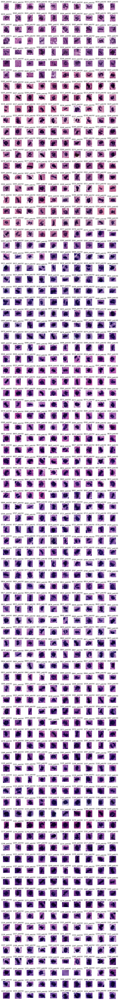

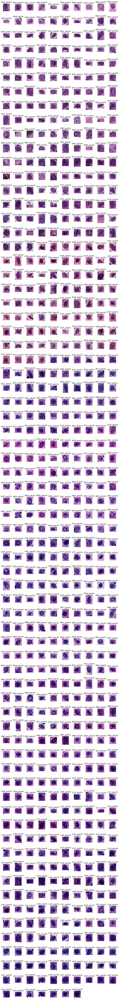

In [72]:
# verify all the patches, seems like test13 and test15 have some issues with the polygon
def visualize_images_in_folder(folder_path, images_per_row=5, figsize=(12, 100)):
    """
    Visualize all images in a folder in a grid layout.

    Args:
        folder_path (str): Path to the folder containing images.
        images_per_row (int): Number of images to display per row.
        figsize (tuple): Size of the matplotlib figure.
    """
    # Get a list of all image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]
    image_files = sorted(image_files)
    num_images = len(image_files)

    if num_images == 0:
        print("No images found in the folder.")
        return

    # Calculate the number of rows needed
    num_rows = (num_images + images_per_row - 1) // images_per_row

    # Create a matplotlib figure
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=figsize)
    fig.tight_layout()

    # If there's only one row, axes will be 1D
    if num_rows == 1:
        axes = axes.reshape(1, -1)

    # Iterate through the images and display them
    for idx, image_file in enumerate(image_files):
        row = idx // images_per_row
        col = idx % images_per_row

        # Open the image using PIL
        image_path = os.path.join(folder_path, image_file)
        try:
            img = Image.open(image_path)
            axes[row, col].imshow(img)
            axes[row, col].set_title('{}'.format(image_file[8:-4]), fontsize='large')
            axes[row, col].axis('off')  # Hide axes
        except Exception as e:
            print(f"Error loading image {image_file}: {e}")
            axes[row, col].axis('off')  # Hide axes if image fails to load

    # Hide empty subplots
    for idx in range(num_images, num_rows * images_per_row):
        row = idx // images_per_row
        col = idx % images_per_row
        axes[row, col].axis('off')

    plt.show()

# Example usage
folder_path = "./Training_patches/1_Mitosis"  # Replace with your folder path
visualize_images_in_folder(folder_path, images_per_row=10)
# Example usage
folder_path = "./Training_patches/0_Non-mitosis"  # Replace with your folder path
visualize_images_in_folder(folder_path, images_per_row=10)